In [1]:
%matplotlib widget

The history saving thread hit an unexpected error (DatabaseError('database disk image is malformed')).History will not be written to the database.


In [2]:
# Import libraries

import numpy as np
import matplotlib.pyplot as plt
import empymod 
from scipy.constants import mu_0
import pygimli as pg
from pygimli.viewer.mpl import drawModel1D
from sklearn.metrics import root_mean_squared_error
from numpy import linalg as LA
from itertools import product
import plotly.express as px
import pandas as pd

In [3]:
def DualEM_842s(sigmas, thicks, coil_orient=np.array(['H', 'P', 'V']), height=0.15):
    """ Here we compute DualEM 842s data using the function `empymod.dipole` function
    for a 1D earth resistivity model
    
    We model the impedance ratio (Z) between the primary (H_p) and secondary (H_s) magnetic fields
    
    The data computed is returned in Quadrature or Out-of-Phase (OP) and In-Phase (IP) components 
    for each coil orientation and coil-coil separation:
    
    H : Horizontal Coplanar -> 2 m, 4 m 8 m coil-coil separation
    V : Vertical Coplanar   -> 2 m, 4 m 8 m coil-coil separation
    P : Perpendicular       -> 2.1 m, 4.1 m 8.1 m coil-coil separation
    Using a Frequency of 9000 Hz
    
    Parameters
    ----------
    sigmas : ndarray
        Logarithm of electrical conductivity values of each layer of the model
        
    thicks : ndarray
        Thicknesses of each layer of the model
        
    coil_orient : array of str, e.g.: np.array(['H', 'V', 'P'])
        coil orientations: 'H' for horizontal coplanar, 'V' for vertical coplanar, 'P' for perpendicular
    
    height : float
        height of the device with respect to ground surface [m]
    
    Returns
    -------
    DualEM : ndarray
        DualEM response [OP, IP] for each coil orientation and each coil offset [ppt]
        in parts per thousand
        
        shape: [nr of coil orientations, 2, nr of coil offsets]  
    """
    
  #  if len(depth) != len(res):
  #      raise TypeError('depth and res arrays should have the same length!')
    
    # Define DualEM 842s parameters
    
    Freq = 9000
    coil_spacing = [2, 4, 8]
    coil_spacing_p = [2.1, 4.1, 8.2]
    
    res_air = 1e6 # air resistivity
    
    sigmas = np.array(sigmas)
    res = np.hstack(([res_air], 1/sigmas))
    
   # print('res: ', res)
    
    depth = np.hstack(([0],-np.cumsum(thicks)))
    
   # print('depth:', depth)
    
    # Define source and receivers geometry
    
    source = [0, 0, -height]
    receivers = [coil_spacing, np.zeros_like(coil_spacing), -height]
    receivers_p = [coil_spacing_p, np.zeros_like(coil_spacing_p), -height]
    
    # Define resistivity model
    #res = np.hstack((res_air, res)) # include air resistivity
    
    # Empty array to store store responses
    OUT = []
    
    # Calculate for horizontal coil orientation
    if any(coil_orient == 'H'):
        # Secondary magnetic field
        H_Hs = empymod.dipole(source, receivers, depth, res, Freq, ab = 66, xdirect = None, 
                              verb=0)*(2j * np.pi * Freq * mu_0) 
        # Primary magnetic field
        H_Hp = empymod.dipole(source, receivers, depth=[], res=[res_air], freqtime = Freq,
                              ab = 66, verb=0)*(2j * np.pi * Freq * mu_0)   
        op = (H_Hs/H_Hp).imag.amp() * 1e3 # Out of Phase
        ip = (H_Hs/H_Hp).real.amp() * 1e3 # In Phase
        OUT.append([op, ip])

    # Calculate for vertical coil orientation
    if any(coil_orient == 'V'):
        # Secondary magnetic field
        V_Hs = empymod.dipole(source, receivers, depth, res, Freq, ab = 55, xdirect = None, 
                              verb=0)*(2j * np.pi * Freq * mu_0) 
        # Primary magnetic field
        V_Hp = empymod.dipole(source, receivers, depth=[], res=[res_air], freqtime = Freq, ab = 55, 
                              verb=0)*(2j * np.pi * Freq * mu_0)
        op = (V_Hs/V_Hp).imag.amp() * 1e3 # Out of Phase
        ip = (V_Hs/V_Hp).real.amp() * 1e3 # In Phase
        OUT.append([op, ip])

    # Calculate for perpendicular coil orientation
    if any(coil_orient == 'P'):
        P_Hs = empymod.dipole(source, receivers, depth, res, Freq, ab = 46, xdirect = None, 
                              verb=0)*(2j * np.pi * Freq * mu_0) 
        P_Hp = empymod.dipole(source, receivers, depth=[], res=[res_air], freqtime= Freq,
                              ab = 66, verb = 0)*(2j * np.pi * Freq * mu_0) 
        op = (P_Hs/P_Hp).imag.amp() * 1e3 # Out of Phase
        ip = (P_Hs/P_Hp).real.amp() * 1e3 # In Phase

        OUT.append([op, ip])

    return np.array(OUT).ravel() # [HOP, HIP, VOP, VIP, POP, PIP]

In [4]:
class FDEM_1D(pg.frameworks.Modelling):
    """ Class to Initialize the model for Gauss-Newton inversion
    using the quadrature (Q) and in-phase (IP) components of the measurements
    for a n-layered model
    
    Input:

        nlay : number of layers
    """   
    def __init__(self, nlay=3):
        self.nlay = nlay
        mesh = pg.meshtools.createMesh1DBlock(nlay)
        super().__init__()
        self.setMesh(mesh)

    
    def response(self, par):
        """ Compute response vector for a certain model [mod] 
        par = [thickness_1, thickness_2, ..., thickness_n, sigma_1, sigma_2, ..., sigma_n]
        """
      #  print('model:', par)  
        resp = DualEM_842s(sigmas = par[self.nlay-1:],
                           thicks = par[:self.nlay-1]
                              )
        return resp
    
    def response_mt(self, par, i=0):
        """Multi-threaded forward response."""
        return self.response(par)
    
 #   def createJacobian(self, par, factor=1.05): #CHANGE
 #       """ compute Jacobian for a 1D model """
 #       resp = self.response(par)
 #       n_rows = len(resp) # number of data values in data vector
 #       n_cols = len(par) # number of model parameters
 #       J = self.jacobian() # we define first this as the jacobian
 #       J.resize(n_rows, n_cols)
 #       Jt = np.zeros((n_cols, n_rows))
        
 #       modTrans = self.modelTrans(par)
        
 #       for j in range(n_cols):
    #        mod_plus_dx = par.copy()
 #           mod_plus_dx = modTrans.copy()
 #           mod_plus_dx[j] *= factor
            
 #           mod_plus_dx_invTrans = self.modelTrans.invTrans(mod_plus_dx)
 #           Jt[j,:] = (self.response(mod_plus_dx_invTrans) - resp)/factor # J.T in col j
 #       for i in range(n_rows):
 #           J[i] = Jt[:,i]
            
 #       return J
        #print(self.jacobian())
        #print(J)
        #print(Jt)
        
    def drawModel(self, ax, model):
        pg.viewer.mpl.drawModel1D(ax = ax,
                                  model = model,
                                  plot = 'semilogx',
                                  xlabel = 'Electrical conductivity (S/m)',
                                  )
        ax.set_ylabel('Depth in (m)')

In [5]:
# Inversion for 2 Layers

FOP = FDEM_1D(nlay = 2)

sigmas = [900/1000, 20/1000]
thicks = [2]

model_true = thicks + sigmas

data = FOP.response(model_true)

transThk = pg.trans.TransLogLU(0.1,4)
transSig = pg.trans.TransLogLU(1/1000,1000/1000)

FOP.region(0).setTransModel(transThk)
FOP.region(1).setTransModel(transSig)

inv = pg.Inversion()
inv.setForwardOperator(FOP)
#nv.modelTrans = transSig
J = inv.fop.jacobian()

#J = FOP.createJacobian(model_true)

rel_err = np.ones_like(data)*1e-2
model_inv = inv.run(data, rel_err, verbose=True, startModel=[1, 500/1000, 500/1000], lam=0, )

14/02/25 - 14:52:20 - pyGIMLi - INFO - Starting inversion.


min/max(dweight) = 0.162736/28.2019
fop: <__main__.FDEM_1D object at 0x7f9e75a37740>
Data transformation: <pgcore._pygimli_.RTrans object at 0x7f9e74dcc5f0>
Model transformation (cumulative):
	 0 <pgcore._pygimli_.RTransLogLU object at 0x7f9e74df63e0>
	 1 <pgcore._pygimli_.RTransLogLU object at 0x7f9e74df6430>
min/max (data): 3.55/614
min/max (error): 1%/1%
min/max (start model): 0.5/1
--------------------------------------------------------------------------------
use model trans from RegionManager
min/max(dweight) = 0.162736/28.2019
Building constraints matrix
constraint matrix of size(nBounds x nModel) 1 x 3
check Jacobian: wrong dimensions: (0x0) should be (18x3)  force: 1
jacobian size invalid, forced recalc: 1
inv.iter 0 ... chi² = 8118.19
--------------------------------------------------------------------------------
inv.iter 1 ... Calculating Jacobian matrix (forced=1)...Create Jacobian matrix (brute force) ... ... 0.0077973 s.
... 0.0112826 s
min data = 3.54586 max data = 614

In [6]:
model_true

[2, 0.9, 0.02]

In [7]:
model_inv

3 [2.3001371792994263, 0.9243773633236414, 0.00110520507527675]

In [8]:
root_mean_squared_error(model_true, model_inv)

0.17419681925499875

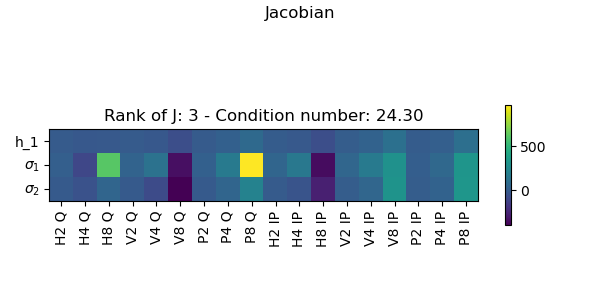

In [9]:
fig, ax = plt.subplots(figsize=(6,3))

c = ax.imshow(np.array(J).T)

fig.colorbar(c, shrink=0.5)

xticks = ['H2 Q', 'H4 Q', 'H8 Q', 'V2 Q', 'V4 Q', 'V8 Q', 'P2 Q', 'P4 Q', 'P8 Q',
          'H2 IP', 'H4 IP', 'H8 IP', 'V2 IP', 'V4 IP', 'V8 IP', 'P2 IP', 'P4 IP', 'P8 IP' ]

yticks = ['h_1', '$\sigma_1$', '$\sigma_2$' ]

ax.set_xticks(range(len(data)), labels=xticks, rotation = 90)
ax.set_yticks(range(len(model_true)), labels=yticks)

ax.set_title('Rank of J: ' + str( np.linalg.matrix_rank(J)) +' - Condition number: %.2f' %np.linalg.cond(J) )

fig.suptitle('Jacobian')

plt.tight_layout()

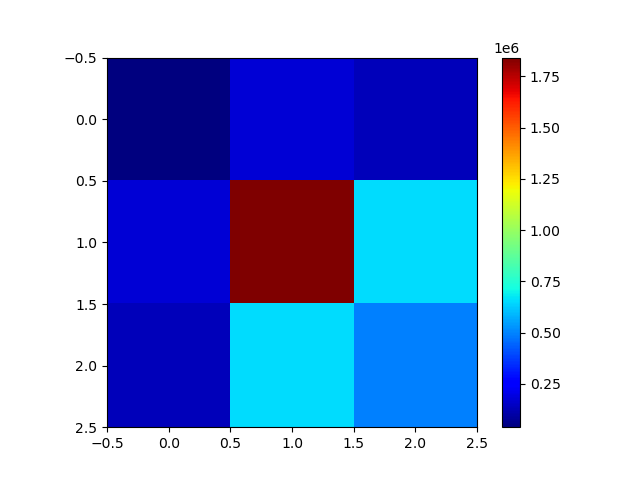

In [10]:
J = np.array(J)

JTJ = J.T.dot(J)

fig, ax = plt.subplots()
c = ax.imshow(JTJ, cmap='jet')
fig.colorbar(c)

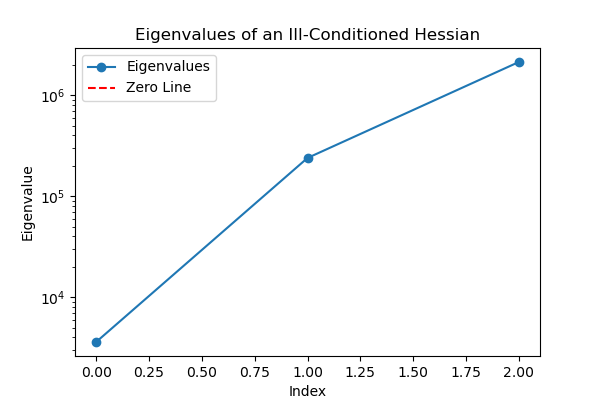

Condition Number: 5.91e+02


In [11]:
# Compute eigenvalues
eigenvalues = np.linalg.eigvalsh(JTJ)  # More stable for symmetric matrices

# Plot eigenvalues
plt.figure(figsize=(6, 4))
plt.semilogy(eigenvalues, 'o-', label="Eigenvalues")
plt.axhline(y=0, color='r', linestyle='--', label="Zero Line")
plt.xlabel("Index")
plt.ylabel("Eigenvalue")
plt.title("Eigenvalues of an Ill-Conditioned Hessian")
plt.legend()
plt.show()

# Print condition number
condition_number = np.max(eigenvalues) / np.min(eigenvalues)
print(f"Condition Number: {condition_number:.2e}")

In [12]:
eigenvalues

array([   3607.19322262,  239108.14286598, 2130195.92546019])

In [29]:
# Test several 2-Layered models upper resistive layer

sigma_1 = np.logspace(0,2, 10)/1000
sigma_2 = np.logspace(1,3, 10)/1000
thicks_1 = np.linspace(0.1,4, 10)
models = np.array(list(product(thicks_1,sigma_1, sigma_2)))

J_s = []
model_inv_s = []
nrmse_h1 = []
nrmse_s1 = []
nrmse_s2 = []
eigenvalues_H_s = []
rank_J_s = []
condition_number_J_s = []
eigenvalues_H_s = []
condition_number_H_s = []

transThk = pg.trans.TransLogLU(0.1,4)
transSig = pg.trans.TransLogLU(1/1000,1000/1000)

for m in models:
  #  print('model:', m)
    FOP = FDEM_1D(nlay = 2)
    
    FOP.region(0).setTransModel(transThk)
    FOP.region(1).setTransModel(transSig)

    model_true = m
    data = FOP.response(model_true)
    
    inv = pg.Inversion()
    inv.setForwardOperator(FOP)
    
    J = inv.fop.jacobian()

    # Invert
    rel_err = np.ones_like(data)*1e-2
    model_inv = inv.run(data, rel_err, verbose=False, startModel=[1, 500/1000, 500/1000], lam=0, )
    model_inv_s.append(model_inv)
    
    nrmse_h1.append(root_mean_squared_error([model_true[0]],[model_inv[0]])/model_true[0])
    nrmse_s1.append(root_mean_squared_error([model_true[1]],[model_inv[1]])/model_true[1])
    nrmse_s2.append(root_mean_squared_error([model_true[2]],[model_inv[2]])/model_true[2])
    
    # Calculate Jacobian
    J = np.array(J)
    J_s.append(J)
    rank_J_s.append(np.linalg.matrix_rank(J))
    condition_number_J_s.append(np.linalg.cond(J))
    
    # Calculate hessian
    JTJ = J.T.dot(J)
    eigenvalues, eigenvectors = LA.eig(JTJ)
    eigenvalues_H_s.append(eigenvalues)
    condition_number_H = np.max(eigenvalues) / np.min(eigenvalues)
    condition_number_H_s.append(condition_number_H)

/tmp/ipykernel_717/3382885093.py:56: RuntimeWarning: divide by zero encountered in scalar divide
  condition_number_H = np.max(eigenvalues) / np.min(eigenvalues)


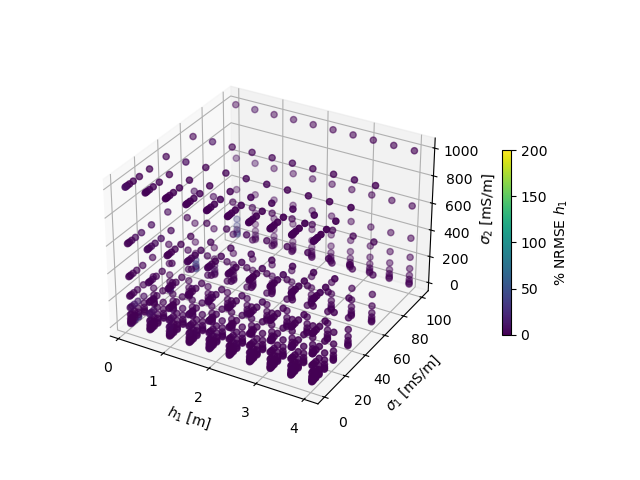

In [76]:
from mpl_toolkits.mplot3d import axes3d

ax = plt.figure().add_subplot(projection='3d')

X = models[:,0]
Y = models[:,1]*1000
Z = models[:,2]*1000

c = ax.scatter(X,Y,Z, c = nrmse_h1, vmin=0, vmax=200)

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')

fig.colorbar(c, label='% NRMSE $h_1$', shrink=0.5, pad=0.1)

#plt.tight_layout()

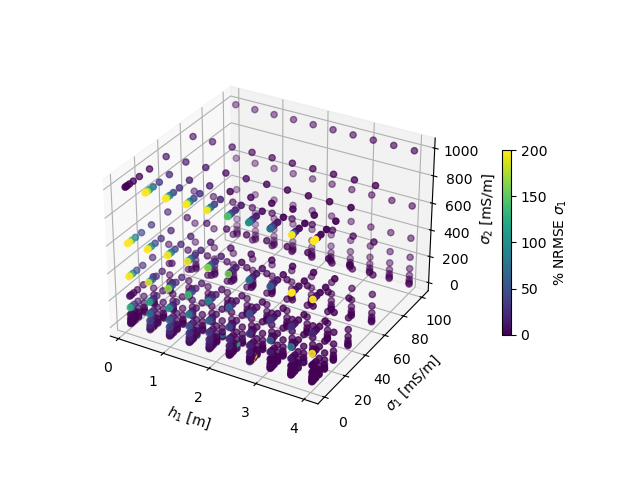

In [77]:
ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = nrmse_s1, vmin=0, vmax=200)

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='% NRMSE $\sigma_1$', shrink=0.5, pad=0.1)

#plt.tight_layout()

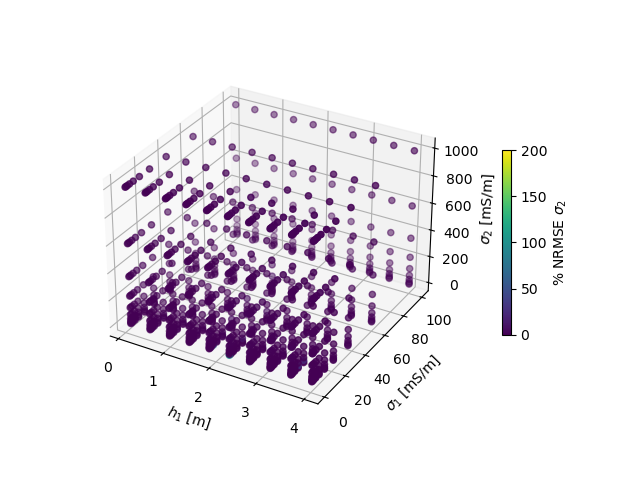

In [78]:
ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = nrmse_s2, vmin=0, vmax=200)

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='% NRMSE $\sigma_2$', shrink=0.5, pad=0.1)

#plt.tight_layout()

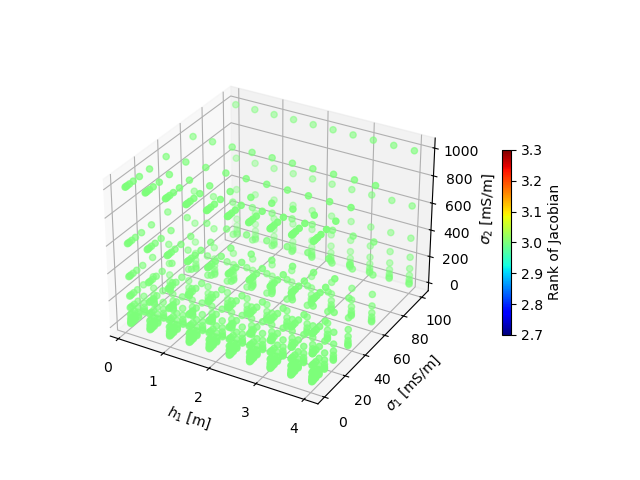

In [57]:
ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = rank_J_s, cmap='jet')

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='Rank of Jacobian', shrink=0.5, pad=0.1)

#plt.tight_layout()

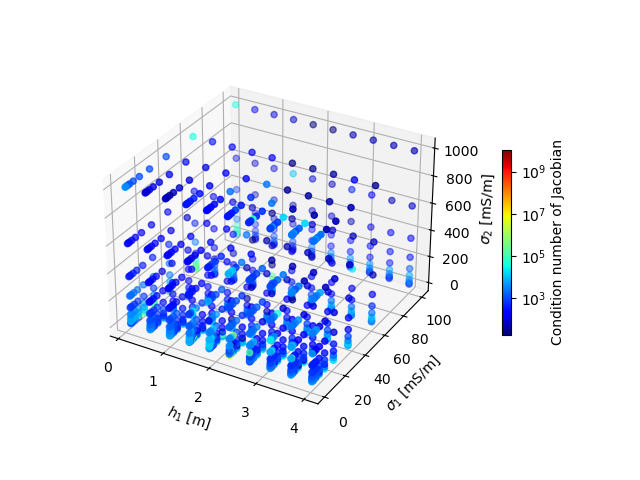

In [63]:
import matplotlib.colors as colors

ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = condition_number_J_s, cmap='jet', norm=colors.LogNorm())

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='Condition number of Jacobian', shrink=0.5, pad=0.1, )

#plt.tight_layout()

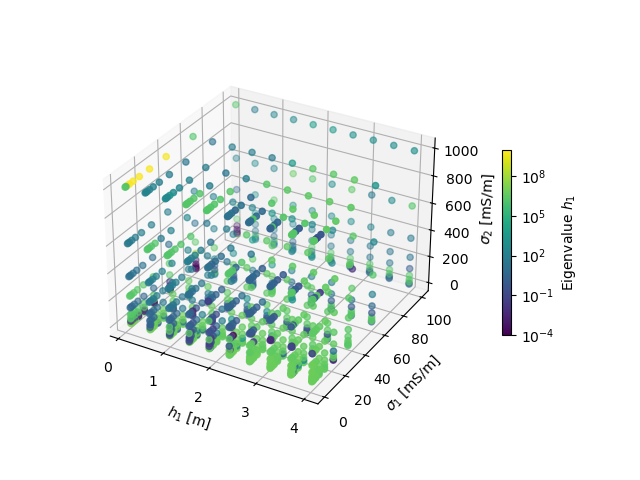

In [73]:
ev_h1 = np.array(eigenvalues_H_s)[:,0]
ev_s1 = np.array(eigenvalues_H_s)[:,1]
ev_s2 = np.array(eigenvalues_H_s)[:,2]

ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = ev_h1, norm=colors.LogNorm(vmin=1e-4, vmax=1e10))

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='Eigenvalue $h_1$', shrink=0.5, pad=0.1, )


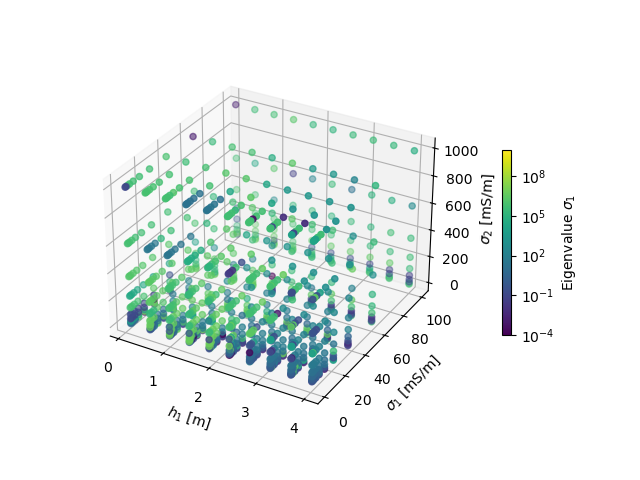

In [74]:
ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = ev_s1, norm=colors.LogNorm(vmin=1e-4, vmax=1e10))

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='Eigenvalue $\sigma_1$', shrink=0.5, pad=0.1, )

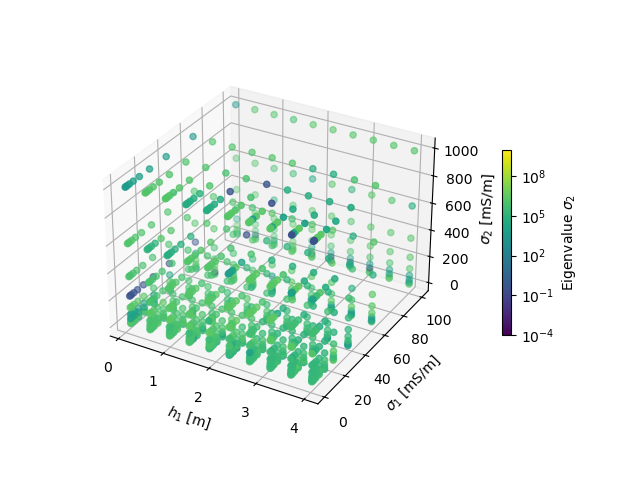

In [75]:
ax = plt.figure().add_subplot(projection='3d')

c = ax.scatter(X,Y,Z, c = ev_s2, norm=colors.LogNorm(vmin=1e-4, vmax=1e10))

ax.set_xlabel('$h_1$ [m]')
ax.set_ylabel('$\sigma_1$ [mS/m]')
ax.set_zlabel('$\sigma_2$ [mS/m]')
fig.colorbar(c, label='Eigenvalue $\sigma_2$', shrink=0.5, pad=0.1, )

In [127]:
models_ = models.copy()
models_[:,1:] = models[:,1:]*1000

df1 = pd.DataFrame(models_, columns=['h_1', 'sigma_1', 'sigma_2'])

df2 = pd.DataFrame(np.array([np.array(nrmse_h1), np.array(nrmse_s1), np.array(nrmse_s2), np.array(rank_J_s),
                    np.array(condition_number_J_s), ev_h1, ev_s1, ev_s2, np.array(condition_number_H_s)]).T,
                   columns = ['nrmse_h1', 'nrmse_s1', 'nrmse_s2', 'rank_J', 'CN_J', 'ev_h1', 'ev_s1', 'ev_s2', 'CN_H'])

df = pd.concat([df1, df2], axis=1)


In [155]:
fig = px.parallel_coordinates(df, color="nrmse_h1", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                              range_color=[0,30]
                             )
fig.show()

In [132]:
fig = px.parallel_coordinates(df, color="nrmse_s1", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                              range_color=[0,30]
                             )
fig.show()

In [133]:
fig = px.parallel_coordinates(df, color="nrmse_s2", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                              range_color=[0,30]
                             )
fig.show()

In [156]:
fig = px.parallel_coordinates(df, color="rank_J", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.diverging.balance,
                             # range_color=[0,30]
                             )
fig.show()

In [161]:
fig = px.parallel_coordinates(df, color="CN_J", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                             range_color=[1, 1e6],
                          
                             )
fig.show()

In [162]:
fig = px.parallel_coordinates(df, color="ev_h1", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                          #   range_color=[10, 1e10],
                          
                             )
fig.show()

In [163]:
fig = px.parallel_coordinates(df, color="ev_s1", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                          #   range_color=[10, 1e10],
                          
                             )
fig.show()

In [164]:
fig = px.parallel_coordinates(df, color="ev_s2", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                          #   range_color=[10, 1e10],
                          
                             )
fig.show()

In [165]:
fig = px.parallel_coordinates(df, color="CN_H", dimensions=['h_1', 'sigma_1', 'sigma_2'],
                             color_continuous_scale=px.colors.sequential.Aggrnyl,
                          #   range_color=[10, 1e10],
                          
                             )
fig.show()